In [1]:
using thesis
using StatsPlots
using PRMaps
using PyCall
using Healpix
using Random, Distributions
using LinearAlgebra

import Stripeline as Sl

In [2]:
a = Instrument(name = "cbass", frequency = 5.0, noisePerPixel = 72.0)
b = Instrument(name = "quijote_11", frequency = 11.0, noisePerPixel = 64.0)
c = Instrument(name = "quijote_13", frequency = 13.0, noisePerPixel = 90.0)
d = Instrument(name = "strip", frequency = 43.0, noisePerPixel = 1.8)

instruments = [a,b,c,d]

4-element Vector{Instrument}:
 Instrument("cbass", 5.0, 72.0)
 Instrument("quijote_11", 11.0, 64.0)
 Instrument("quijote_13", 13.0, 90.0)
 Instrument("strip", 43.0, 1.8)

In [3]:
nside = 64

cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 50,
    total_time_s = 24. * 3600. * 1.
    )
nothing

# Run simulation without the error

In [4]:
result = run_simulation(instruments, cam_ang, setup, nside)

Dict{Any, Any} with 18 entries:
  "nit"       => 4
  "x"         => [1.60556, 20.0001, -3.00001]
  "hess_inv"  => [0.41215 -0.00128839 -8.40844e-5; -0.00128839 0.999997 -1.7504…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 50
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 38
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.5763e10
  "Sigma"     => [1.61173e16 -7.62848e18 0.00334961; -7.62848e18 3.61063e21 -1.…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [3.47531 0.00734258 5194.02; 0.00734258 1.55133e-5 10.9738; 51…
  "jac"       => [-0.00029761, -6.28896e-7, -0.154515]
  "invAtNA"   => [0.8

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:39: RuntimeWarning: covariance is not positive-semidefinite.
  PyPtr, (PyPtr, PyPtr, PyPtr),


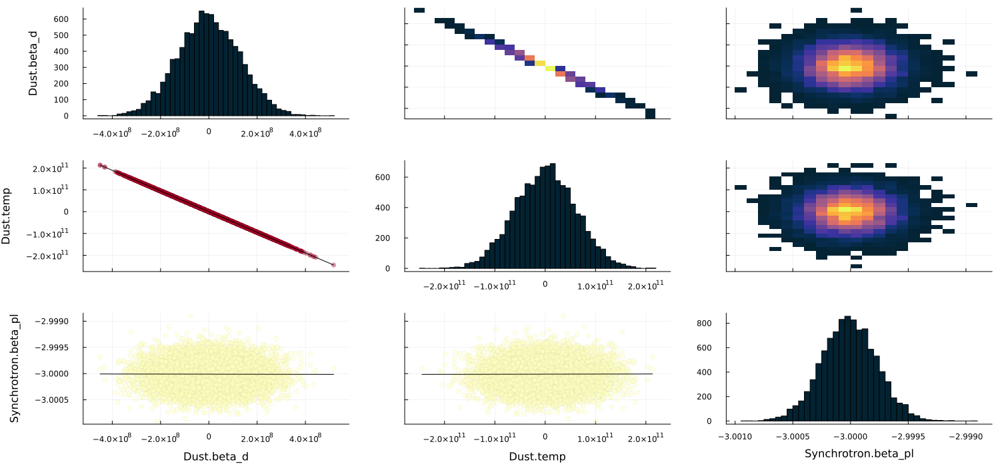

In [5]:
plot(get_corrplot(result))

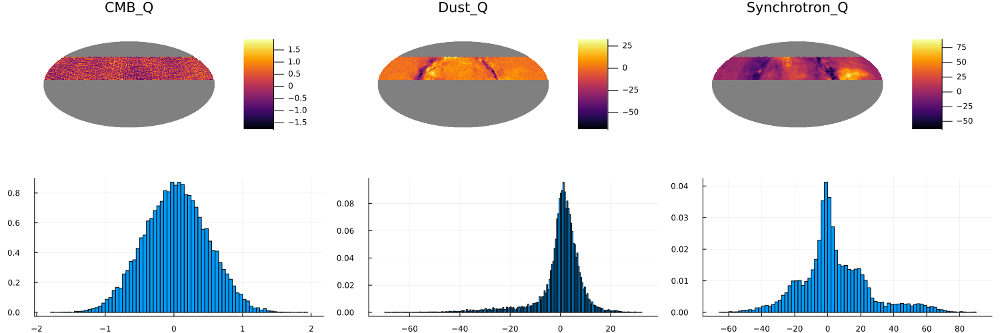

In [9]:
plot(get_map_and_hist(result, "Q", nside))

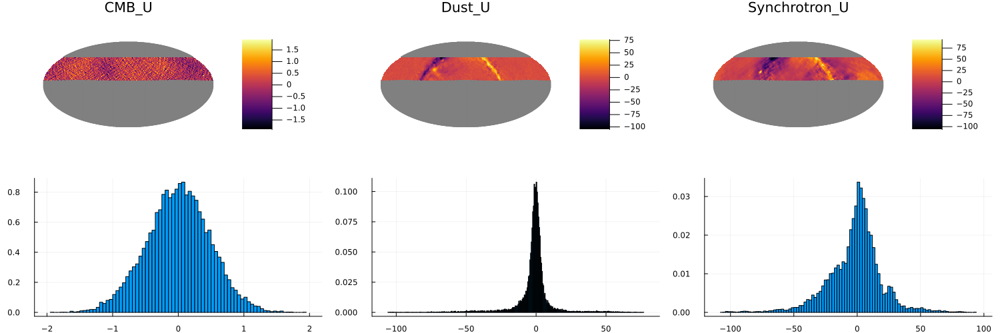

In [10]:
plot(get_map_and_hist(result, "U", nside))